## CNN Audio Style Transfer
This notebook applies CNN14_16k pretrained model to perform audio style transfer.

### Import necessary dependencies

In [4]:
!git clone https://github.com/harritaylor/torchvggish.git
!git clone https://github.com/qiuqiangkong/audioset_tagging_cnn.git 

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvggish.torchvggish.vggish_input import waveform_to_examples
import librosa
import os

%run audioset_tagging_cnn/pytorch/models.py

### Utils

#### Loss computation

In [6]:
class ContentLoss(nn.Module):
    def __init__(self, target,):
        super(ContentLoss, self).__init__()
        self.target = target.detach()

    def forward(self, input):
        self.loss = F.mse_loss(input, self.target)
        return input

def gram_matrix(input):
    a, b, c, d = input.size()
    features = input.view(a * b, c * d)
    G = torch.mm(features, features.t())
    return G.div(a * b * c * d)

class StyleLoss(nn.Module):
    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = gram_matrix(target_feature).detach()
    def forward(self, input):
        G = gram_matrix(input)
        self.loss = F.mse_loss(G, self.target)
        return input

#### Model definition and optimization

In [7]:
content_layers_default = ['conv_block1']
# style_layers_default = ['conv_block1', 'conv_block2', 'conv_block3', 'conv_block4', 'conv_block5', 'conv_block6']
style_layers_default = ['conv_block1', 'conv_block2', 'conv_block3', 'conv_block4']

def get_style_model_and_losses(model_name,
                               style_audio, content_audio,
                               content_layers=content_layers_default,
                               style_layers=style_layers_default):
    content_losses = []
    style_losses = []
    model = nn.Sequential()

    i = 0

    name = str()
    for block in model_name.named_children():
        if "conv_block" in block[0]:
            i += 1
            name = 'conv_block{}'.format(i)
            model.add_module(name, block[1])

        if name in content_layers:
            target = model(content_audio).detach()
            content_loss = ContentLoss(target)
            model.add_module("content_loss_{}".format(i), content_loss)
            content_losses.append(content_loss)

        if name in style_layers:
            target_feature = model(style_audio).detach()
            style_loss = StyleLoss(target_feature)
            model.add_module("style_loss_{}".format(i), style_loss)
            style_losses.append(style_loss)

    for i in range(len(model) - 1, -1, -1):
      if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
          break
    #print(i)
    model = model[:(i + 1)]

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    return model, style_losses, content_losses

def get_input_optimizer(input_audio):
    optimizer = optim.LBFGS([input_audio])
    return optimizer

def run_audio_style_tranfer(model, content_audio, style_audio, input_audio, num_steps=300,
                       style_weight=1000000, content_weight=1):
    print('Building the style transfer model..')

    model, style_losses, content_losses = get_style_model_and_losses(model,style_audio,content_audio)

    input_audio.requires_grad_(True)
    model.eval()
    model.requires_grad_(False)

    optimizer = get_input_optimizer(input_audio)

    print('Optimizing..')
    run = [0]
    while run[0] <= num_steps:

      def closure():
        # with torch.no_grad():
        #     input_audio.clamp_(0, 1)

        optimizer.zero_grad()
        model(input_audio)
        style_score = 0
        content_score = 0

        for sl in style_losses:
            style_score += sl.loss
        for cl in content_losses:
            content_score += cl.loss

        style_score *= style_weight
        content_score *= content_weight

        loss = style_score + content_score
        loss.backward()

        run[0] += 1
        if run[0] % 10 == 0:
            print("run {}:".format(run))
            print('Style Loss : {:4f} Content Loss: {:4f}'.format(
                style_score.item(), content_score.item()))
            print()

        return style_score + content_score

      optimizer.step(closure)

    # with torch.no_grad():
    #     input_img.clamp_(0, 1)

    return input_audio

### Load pretrained model

In [8]:
model_path = "Cnn14_16k_mAP=0.438.pth"
model = torch.load(model_path, map_location=torch.device("cpu"))

In [9]:
cnn_audio = Cnn14_16k(sample_rate=16000,
                       window_size=512,
                       hop_size=160,
                       mel_bins=64,
                       fmin=50,
                       fmax=8000,
                       classes_num=527)
cnn_audio.load_state_dict(model["model"])
cnn_audio.eval()

Cnn14_16k(
  (spectrogram_extractor): Spectrogram(
    (stft): STFT(
      (conv_real): Conv1d(1, 257, kernel_size=(512,), stride=(160,), bias=False)
      (conv_imag): Conv1d(1, 257, kernel_size=(512,), stride=(160,), bias=False)
    )
  )
  (logmel_extractor): LogmelFilterBank()
  (spec_augmenter): SpecAugmentation(
    (time_dropper): DropStripes()
    (freq_dropper): DropStripes()
  )
  (bn0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv_block1): ConvBlock(
    (conv1): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_block2): ConvBlock(
    (conv1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    

### Load audio files

In [2]:
script_directory = os.getcwd()
data_folder = os.path.join(script_directory, '..', 'data')
content_path= os.path.join(data_folder,  "yursong.wav")
style_path = os.path.join(data_folder,  "yursong_drum.wav")

In [3]:
x, fs = librosa.load(content_path, sr=16000)
style_audio = waveform_to_examples(x, fs)
x1, fs1 = librosa.load(style_path, sr=16000)
content_audio = waveform_to_examples(x1, fs1)

#First test: assume style audio length > content audio length

style_audio = style_audio[:content_audio.shape[0],:,:,:]
print("Size of style audio: ", style_audio.shape)
print("Size of content audio: ", content_audio.shape)

Size of style audio:  torch.Size([98, 1, 96, 64])
Size of content audio:  torch.Size([98, 1, 96, 64])


In [12]:
start = 0 # audio starting point (optional) 
duration = 5 # audio duration (optional)

style_audio = style_audio[start:start+duration,:,:,:]
content_audio = content_audio[start:start+duration,:,:,:]
print("New size of style audio: ", style_audio.shape)
print("New size of content audio: ", content_audio.shape)

New size of style audio:  torch.Size([5, 1, 96, 64])
New size of content audio:  torch.Size([5, 1, 96, 64])


### Running and visualizing

In [13]:
input_audio = torch.randn(content_audio.data.size(), requires_grad=True)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("device = {}".format(device))
content_audio.to(device=device)
style_audio.to(device=device)
input_audio.to(device=device)

output_audio = run_audio_style_tranfer(cnn_audio, content_audio, style_audio, input_audio, num_steps=50, style_weight=1000000, content_weight=1)

device = cpu
Building the style transfer model..
Optimizing..
run [10]:
Style Loss : 0.024059 Content Loss: 0.135281

run [20]:
Style Loss : 0.021386 Content Loss: 0.063935

run [30]:
Style Loss : 0.020627 Content Loss: 0.045898

run [40]:
Style Loss : 0.019854 Content Loss: 0.039692

run [50]:
Style Loss : 0.018617 Content Loss: 0.035220

run [60]:
Style Loss : 0.017296 Content Loss: 0.029896



We convert the output from melspectrogram to audio file.

In [14]:
import numpy as np

num_exs,_,frames,bands = output_audio.shape
output_test = np.zeros((64, 480))
output_test[:,:480] = torch.reshape(output_audio, (num_exs*frames, bands)).detach().numpy().T


audio_sample_rate = 16000
window_length_secs = 0.025
hop_length_secs = 0.01
window_length_samples = int(round(audio_sample_rate * window_length_secs))
hop_length_samples = int(round(audio_sample_rate * hop_length_secs))
fft_length = 2 ** int(np.ceil(np.log(window_length_samples) / np.log(2.0)))

a_o = librosa.feature.inverse.mel_to_stft(output_test, sr=audio_sample_rate, power=1, n_fft=fft_length)
# a_o = librosa.griffinlim(a_o, n_fft=fft_length, win_length=window_length_samples, hop_length=hop_length_samples)
a_o = librosa.istft(a_o, n_fft=fft_length, win_length=window_length_samples, hop_length=hop_length_samples)

Content


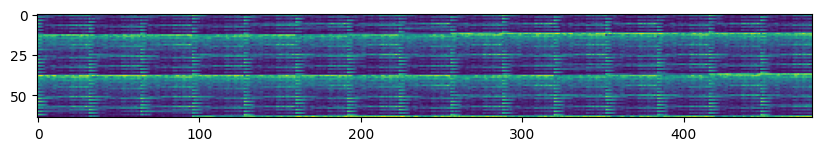

Style


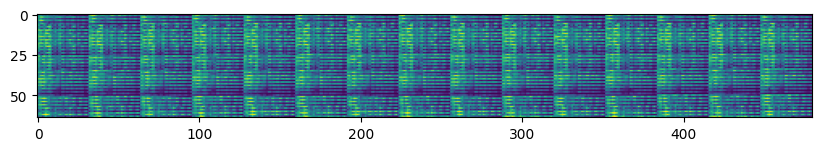

Output


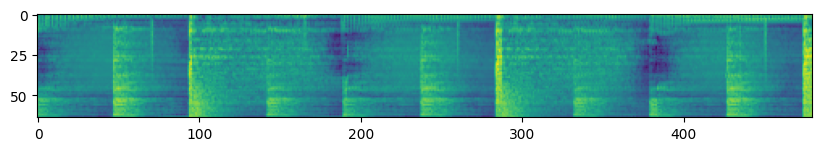

In [15]:
import matplotlib.pyplot as plt
print("Content")
plt.figure(figsize=(10, 5))
plt.imshow(content_audio.detach().numpy().reshape(64,-1))
plt.show()
print("Style")
plt.figure(figsize=(10, 5))
plt.imshow(style_audio.detach().numpy().reshape(64,-1))
plt.show()
print("Output")
plt.figure(figsize=(10, 5))
plt.imshow(output_test)
plt.show()

In [16]:
from IPython.display import Audio, display
import soundfile as sf
OUTPUT_FILENAME = 'out_cnn.wav'

sf.write(OUTPUT_FILENAME, a_o, audio_sample_rate, 'PCM_24')
print("Content")
display(Audio(content_path))
print("Style")
display(Audio(style_path))
print("Output")
display(Audio("out_cnn.wav"))

Content


Style


Output
